In [1]:
import datasource.adbms_dataframe as ds
import reward as rw
from gym_env import VSEnv, VSMonitor
from agent import VSAgent, STB3VSAgent
from policy_baselines import HpaPolicy, BufFillingRatePolicy

# Parameters
RND_SEED = 42
K_ARMS = 3            # 2 arms 0=Decrease buffer size, 1=Stay at current buffer size
USE_SLA_PROTECT=False #use or NOT Use the reactive mode to protect the SLA. Let see where we are going without this protection...
#qpslat_weights="01"   # QPS is not used in performance computation (weigth is 0%), the objective is to maintain te Latency (weigth is 100%). Other options is "19" (10% for QPS, 90% for Latency)

PLOTLY_RENDERER="svg" # "plotly_mimetype+notebook": Ex: png, jpg, svg
TRAINING_VERBOSITY=0

OBSERVATION_SPACE_ELEMS = [
####    "tables",                      # Not significant while in production the DB schema is totaly different than the one built by Sysbench. DB Size should be sufficient
####    "tables_rows",                 # Not significant while in production the DB schema is totaly different than the one built by Sysbench. DB Size should be sufficient
#    "iperf01",                      # Current performance indicator based on WPS and Latency, 01 is computed with weigths as follow: 0% QPS and 100% Latency
    "db_size_mb",                    # Initial DB size after creation of all tables+indexes and before the workload with all clients
    "sysbench_filtered.latency_mean",      # [0, 1000] ms. Filtered latency from client. In inference/live mode, it should be a predicted value (see predictor.ipynb using XGBoost)
#    "buf_size_idx",                      # Index form of the buffer size value [0, 63]
    "observation.normalized_buf_size",     # [0., 1.] Taille normalisée courante du buffer cache
#    "perf_target_level",           # [0., 1.] Objectif de performance cible. Est une valeur fixe lors des entrainements (1 modèle pour 1 objectif de perf)
#    "latency_threshold",           # In ms. Est une valeur fixe lors des entrainements
    "observation.cache_used_pages_ratio",
    "observation.cache_hit_ratio",
    "extra_info.usage.db_size_initial.IndexSizeMB", # Initial Indexes DB size 
    "extra_info.usage.qps",          # QPS picked on server ("Questions" Global status variable throughput)
    "extra_info.global_status.KBps", # Kilo Bytes per seconds picked on server with "Bytes_sent" Global status variable throughput
    "observation.write_wait_ratio",  # Seems not relevant and usable on MariaDB
#    "extra_info.global_status.threads_running_start", # NOT POWERFULL!!?? The number of connections currently running an SQL query. Be carefull of a Bug in some MariaDB versions!! => TOO MUCH NOISE ON ITS VALUE!!!!!
    "extra_info.global_status.created_tmp_tables_diff", # ?
    "extra_info.global_status.handler_delete_diff", # ?
    "extra_info.global_status.handler_update_diff", # ?
    "extra_info.global_status.handler_write_diff", # ?
    "extra_info.global_status.innodb_buffer_pool_read_requests_diff",
    "extra_info.global_status.innodb_buffer_pool_write_requests_diff",
    "extra_info.global_status.innodb_buffer_pool_wait_free_diff",
    "extra_info.global_status.innodb_data_reads_diff",
    "extra_info.global_status.innodb_data_written_diff",
    "extra_info.global_status.max_used_connections_end",
    "extra_info.global_status.threads_running_end",
    "extra_info.global_status.threads_connected_end",
    "extra_info.global_status.innodb_buffer_pool_bytes_dirty_end", # Seems cool to have it
    "extra_info.global_status.innodb_buffer_pool_pages_free_end",  # Seems cool to have it
#    "extra_info.global_status.innodb_buffer_pool_pages_data_diff",
    "extra_info.global_status.innodb_buffer_pool_bytes_dirty_diff", # Seems cool to have it
    "extra_info.global_status.innodb_buffer_pool_pages_free_diff",  # Seems cool to have it
    "extra_info.global_status.information_schema.innodb_metrics.lock_row_lock_time_max",
    "extra_info.global_status.information_schema.innodb_metrics.lock_row_lock_waits",
    "extra_info.global_status.information_schema.innodb_metrics.os_pending_reads",
    "extra_info.global_status.information_schema.innodb_metrics.os_pending_writes",
    "extra_info.global_status.information_schema.innodb_metrics.file_num_open_files",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.MODIFIED_DATABASE_PAGES", # Sounds COOL to have it!!
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_READ_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_CREATE_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_WRITTEN_RATE",  # CATASTROPHIC at an incredible point !!!
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.READ_AHEAD_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.READ_AHEAD_EVICTED_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_MADE_YOUNG_RATE", # Sounds COOL to have it!!
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.POOL_SIZE", # Sounds COOL to have it!!
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.FREE_BUFFERS",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.DATABASE_PAGES",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.OLD_DATABASE_PAGES",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PENDING_DECOMPRESS",       #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PENDING_READS",       #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PENDING_FLUSH_LRU",       #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PENDING_FLUSH_LIST",       #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_MADE_YOUNG",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_NOT_MADE_YOUNG",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.PAGES_MADE_NOT_YOUNG_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_PAGES_READ",       #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_PAGES_CREATED",    #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_PAGES_WRITTEN",    # ? 
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_PAGES_GET",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.HIT_RATE",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.YOUNG_MAKE_PER_THOUSAND_GETS",         #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NOT_YOUNG_MAKE_PER_THOUSAND_GETS",         #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_PAGES_READ_AHEAD",         #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.NUMBER_READ_AHEAD_EVICTED",         #?
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.LRU_IO_TOTAL",
    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.LRU_IO_CURRENT",
#    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.UNCOMPRESS_TOTAL",
#    "extra_info.global_status.information_schema.innodb_buffer_pool_stats.UNCOMPRESS_CURRENT",
]

HPA_OBSERVATION_SPACE_ELEMS = [
    "buf_size_idx",                      # Index form of the buffer size value [0, 63]
    "observation.cache_used_pages_ratio",    # Buffer cache fill rate in [0., 1.]
]
ext_threshold=0.99

BFR_OBSERVATION_SPACE_ELEMS = [
    "observation.cache_used_pages_ratio"
]


#TRAINING_COVERAGE =3.2 # Coverage of the total states present in dataset. 1.0 means that almost all the dataset will be covered (depends also on the random distribution that may repeat twice the same state)
#TRAINING_STEPS_PER_EPISODE = 64 #18    # Important to take benefit of the decreasing exploration vs explotation tradeoff
#TRAINING_VERBOSITY=5
#ALPHA=0.95 # Explore vs exploit

2024-07-03 07:47:07.756815: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-07-03 07:47:07.790067: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 9600 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning: You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)
  warnings.warn(


---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1193     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.17       |
| time/                   |             |
|    fps                  | 628         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.022114575 |
|    clip_fraction        | 0.348       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.36       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8064.0MB Arm-D1 Rew:0.6207 RegCumul:0.0 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S2  Buf:7936.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S3  Buf:7808.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S4  Buf:7680.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0621 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S5  Buf:7552.0MB Arm-D1 Rew:0.6212 RegCumul:0.0 IRegCumul:0.0745 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S6  Buf:7424.0MB Arm-D1 Rew:0.6211 RegCumul:0.0 IRegCumul:0.0869 SLA-OVER                 IPERF01/OBJ:0.99

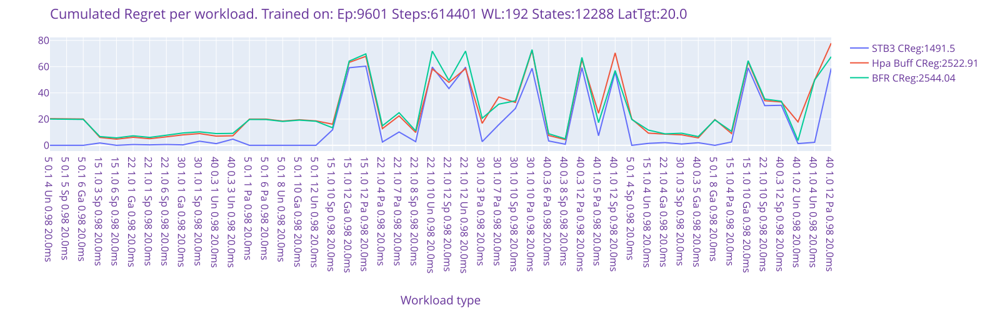

K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 9600 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning:

You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)



---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1248     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.2        |
| time/                   |             |
|    fps                  | 645         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.020868842 |
|    clip_fraction        | 0.305       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8064.0MB Arm-D1 Rew:0.6207 RegCumul:0.0 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S2  Buf:7936.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S3  Buf:7808.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S4  Buf:7680.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0621 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S5  Buf:7552.0MB Arm-D1 Rew:0.6212 RegCumul:0.0 IRegCumul:0.0745 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S6  Buf:7424.0MB Arm-D1 Rew:0.6211 RegCumul:0.0 IRegCumul:0.0869 SLA-OVER                 IPERF01/OBJ:0.99

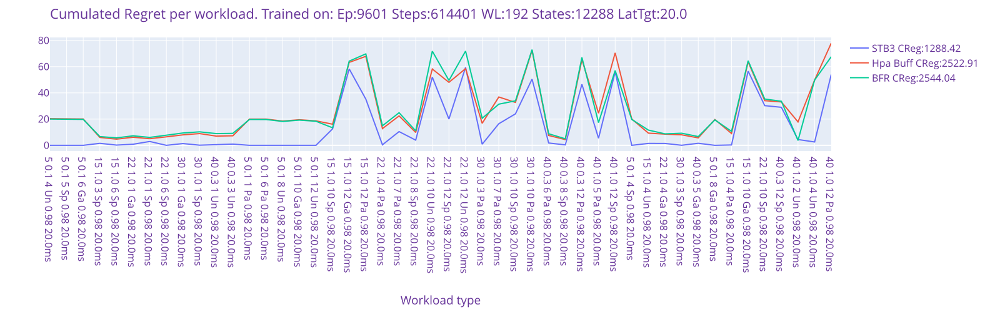

K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 19200 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning:

You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)



---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1257     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.17       |
| time/                   |             |
|    fps                  | 637         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.022114575 |
|    clip_fraction        | 0.348       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.36       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:0.62 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:1.24 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S2  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:1.86 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S3  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:2.48 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S4  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:3.1 IRegCumul:0.062 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S5  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:3.7201 IRegCumul:0.0744 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S6  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:4.3401 IRegCumul:0.0868 SLA-OVER                 IPERF01/OBJ:

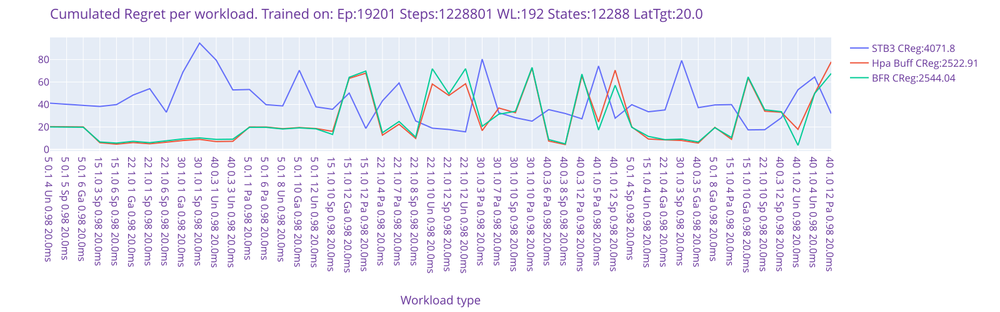

K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 19200 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning:

You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)



---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1224     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.2        |
| time/                   |             |
|    fps                  | 638         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.020868842 |
|    clip_fraction        | 0.305       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8064.0MB Arm-D1 Rew:0.6207 RegCumul:0.0 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S2  Buf:7936.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S3  Buf:7808.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S4  Buf:7680.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0621 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S5  Buf:7552.0MB Arm-D1 Rew:0.6212 RegCumul:0.0 IRegCumul:0.0745 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S6  Buf:7424.0MB Arm-D1 Rew:0.6211 RegCumul:0.0 IRegCumul:0.0869 SLA-OVER                 IPERF01/OBJ:0.99

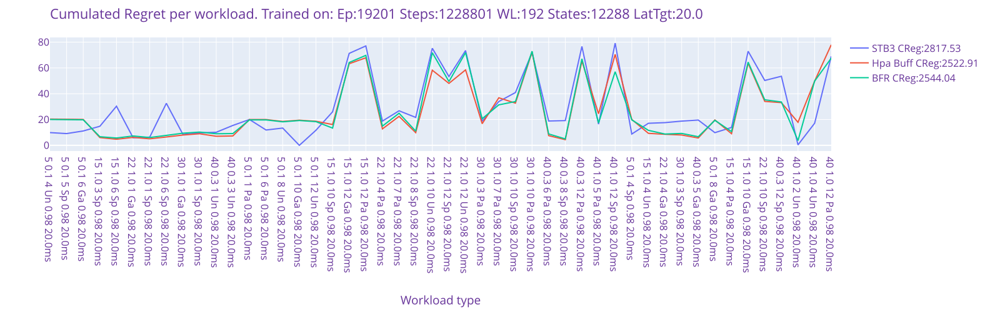

K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 23040 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning:

You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)



---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1260     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.17       |
| time/                   |             |
|    fps                  | 641         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.022114575 |
|    clip_fraction        | 0.348       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.36       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:0.62 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:1.24 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S2  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:1.86 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S3  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:2.48 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S4  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:3.1 IRegCumul:0.062 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S5  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:3.7201 IRegCumul:0.0744 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S6  Buf:8192.0MB Arm-S0 Rew:0.0004 RegCumul:4.3401 IRegCumul:0.0868 SLA-OVER                 IPERF01/OBJ:

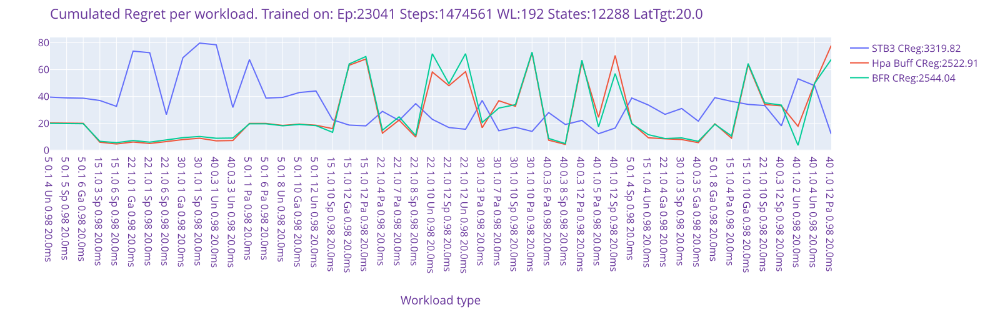

K_ARMS:3 STAY_ARM_IDX:1
Sample_states len: 12288 #Workloads:192
Using cpu device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Train on 23040 episodes of 64 steps Print every 0step


/usr/local/lib/python3.10/site-packages/stable_baselines3/ppo/ppo.py:155: UserWarning:

You have specified a mini-batch size of 1536, but because the `RolloutBuffer` is of size `n_steps * n_envs = 512`, after every 0 untruncated mini-batches, there will be a truncated mini-batch of size 512
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=512 and n_envs=1)



---------------------------------
| rollout/           |          |
|    ep_len_mean     | 64       |
|    ep_rew_mean     | -9.63    |
| time/              |          |
|    fps             | 1233     |
|    iterations      | 1        |
|    time_elapsed    | 0        |
|    total_timesteps | 512      |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 64          |
|    ep_rew_mean          | -6.2        |
| time/                   |             |
|    fps                  | 634         |
|    iterations           | 2           |
|    time_elapsed         | 1           |
|    total_timesteps      | 1024        |
| train/                  |             |
|    approx_kl            | 0.020868842 |
|    clip_fraction        | 0.305       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.39       |
|    explained_variance   | 0.0194      |
|    learning_rate        | 0.

Sample_states len: 3072 #Workloads:48
Train on 96 episodes of 64 steps Print every 1step
E0 5 0.1 4 Un 0.98 20.0ms DBSize:122MB Dft DBA:256.0MB 
S0  Buf:8192.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0124 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.6ms 
S1  Buf:8064.0MB Arm-D1 Rew:0.6207 RegCumul:0.0 IRegCumul:0.0248 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S2  Buf:7936.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0372 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S3  Buf:7808.0MB Arm-D1 Rew:0.6204 RegCumul:0.0 IRegCumul:0.0496 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S4  Buf:7680.0MB Arm-D1 Rew:0.6208 RegCumul:0.0 IRegCumul:0.0621 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.59ms 
S5  Buf:7552.0MB Arm-D1 Rew:0.6212 RegCumul:0.0 IRegCumul:0.0745 SLA-OVER                 IPERF01/OBJ:0.992/0.98 LAT:7.58ms 
S6  Buf:7424.0MB Arm-D1 Rew:0.6211 RegCumul:0.0 IRegCumul:0.0869 SLA-OVER                 IPERF01/OBJ:0.99

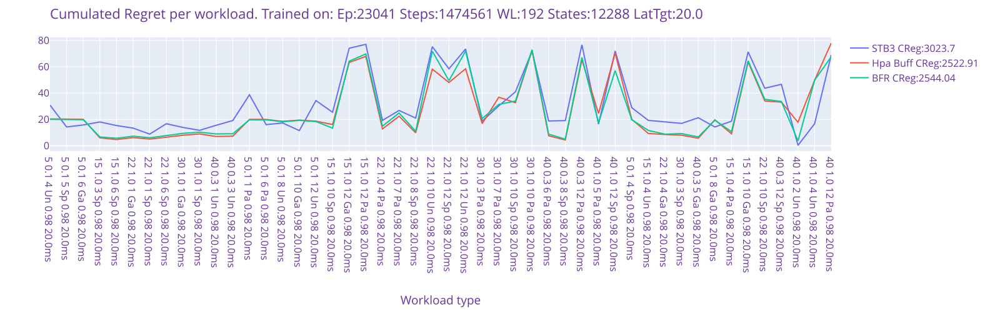

In [3]:
from stable_baselines3 import PPO, SAC, DDPG
from policy_sb3 import SB3Policy

dataset_elems1=[[ "special", "gaussian", "uniform", "pareto" ]] # [ [ "special" ], [ "special", "gaussian"], [ "special", "gaussian", "uniform" ]]
dataset_elems2=[[1,  2,  3,  4,  5,  6,  7,  8, 10, 12]] #[ [2,3,4,6], [ 2,  3,  4,  6,  8, 10, 12], [1,  2,  3,  4,  5,  6,  7,  8, 10, 12] ]

traincov_elems=[6, 9, 20] #[1,3,6]
trainsteps_elems=[64] #[1, 64]

alpha_elems=[0.0009, 0.0003]

ACTION_MINMAX = (-1,1)  # The Min and Max action values. Arms count and the position of the "STAY" arm are depending on it.
TEST_AS_TRAIN=False
DATAFRAME_VERSION=9

for dse1 in dataset_elems1:
    for dse2 in dataset_elems2:
        datasets = ds.TrainTestDataSets(testastrain=TEST_AS_TRAIN, version=DATAFRAME_VERSION, randtypes=dse1, clients=dse2, seed=RND_SEED, verbose=0)

        SIGMA_TIPPING_RATIO=-1 #-1 #0.9375 # The sigma value for the random gaussian distribution around the "mean" (or "mu"), the point of SLA tipping. If <0 use the auto-computing based on tipping point.
        #ds_train1 = ds.ADBMSBufferCacheStatesFullRandomSelector(datasets.df_train, sigma_tipping_ratio=SIGMA_TIPPING_RATIO, seed=RND_SEED)
        ds_train2 = ds.ADBMSBufferCacheStatesRandomBufferSelector(datasets.df_train, sigma_tipping_ratio=SIGMA_TIPPING_RATIO, seed=RND_SEED)
        #ds_train3 = ds.ADBMSBufferCacheStatesSequentialSelector(datasets.df_train, topdown=True)
        

        ds_states_elems = [ds_train2]

        ds_states_test = ds.ADBMSBufferCacheStatesSequentialSelector(datasets.df_test, topdown=True)

        for TRAINING_COVERAGE in traincov_elems:
            for TRAINING_STEPS_PER_EPISODE in trainsteps_elems:
                for ALPHA in alpha_elems:
                    for ds_states in ds_states_elems:
                        ds_states.prepareContext(OBSERVATION_SPACE_ELEMS, check_data=False, normalize=True)
                        # Continous reward in range [-1., 1.] is computed. The best arm is the one having the maximum value
                        reward = rw.ADBMSBufferCacheRewardContinousV3(action_minmax=ACTION_MINMAX)
                        reward_test = rw.ADBMSBufferCacheRewardContinousV3(action_minmax=(-1,1))
                        reward_hpa = rw.ADBMSBufferCacheRewardContinousV3(action_minmax=(-63, 63))
                        K_ARMS = reward.getActionsCount()
                        K_ARM_STAY = reward.getActionStayIdx()          # The index of the "STAY" arm
                        print(f'K_ARMS:{K_ARMS} STAY_ARM_IDX:{K_ARM_STAY}')

                        env_train = VSMonitor(VSEnv(ds_states, reward=reward, notify_react=False, max_steps_per_episode=TRAINING_STEPS_PER_EPISODE, verbose=0))

                        n_epochs=round(env_train.unwrapped.ds.getTotalStatesCount() // TRAINING_STEPS_PER_EPISODE)#*ds_train.getWorkloadsCount()
                        model = PPO("MlpPolicy", env_train, learning_rate=ALPHA, n_steps=TRAINING_STEPS_PER_EPISODE*ds_states.getWorkloadsCount()//24, batch_size=TRAINING_STEPS_PER_EPISODE*24, n_epochs=n_epochs, gamma=0.99, gae_lambda=0.95, clip_range=0.2, ent_coef=0, vf_coef=1, use_sde=False, seed=RND_SEED, verbose=1)

                        policy = SB3Policy(reward.actions, ctx=ds_states.contextElems(), model=model)

                        stb3_agent = STB3VSAgent(policy)
                        stb3_agent.learn(env_train, TRAINING_COVERAGE, verbose=TRAINING_VERBOSITY)
                        env_train.close()
                        stb3_agent.showLearnFig(head_title=f"LEARN/{policy.name} TotalSteps:{env_train.unwrapped.total_steps}", renderer=None)

                        # Environement for test. 
                        ds_states_test = ds.ADBMSBufferCacheStatesTopDownRockerSelector(datasets.df_test)               # Start sequentialy each workload twice. First from Top, second from Bottom
                        TEST_EPISODES_COUNT = -2    # If <0, abs(EPISODES_COUNT) is a multiple of workloads count 
                        TEST_STEPS_PER_EPISODE = -1 # If <0, abs(STEPS_PER_EPISODE) is a multiple of buffer values count 

                        ds_states_test.prepareContext(OBSERVATION_SPACE_ELEMS, normalize=True, with_scaler=ds_states.min_max_scaler) 

                        # Environement for test with VSMonitor Wrapper. 
                        env_test = VSMonitor(VSEnv(ds_states_test, reward=reward, notify_react=False, max_steps_per_episode=TEST_STEPS_PER_EPISODE, verbose=1))
                        stb3_agent.policy.deterministic = False # Choosing True seems to work badly
                        stb3_agent.predict(env_test, episodes_max=TEST_EPISODES_COUNT)

                        graph_tests = env_test.graphPerWorkload(f"Cumulated Regret per workload. Trained on: {env_train.unwrapped.msgStatus()} {env_train.unwrapped.desc()}")
                        graph_tests.addCurve(f"{policy.name} CReg:{round(env_test.getRegretPerformance(),2)}", y=env_test.resultPerWorkload())
                        env_test.close()

                        # Test Baseline policies
                        # HPA policy
                        ds_states_test.prepareContext(HPA_OBSERVATION_SPACE_ELEMS)

                        env_test = VSMonitor(VSEnv(ds_states_test, reward=reward_hpa, notify_react=False, max_steps_per_episode=TEST_STEPS_PER_EPISODE, verbose=1))

                        policy = HpaPolicy(reward_hpa.actions, ctx=ds_states_test.contextElems(), ext_threshold=ext_threshold, debug=False)
                        hpa_agent = VSAgent(policy)
                        # No traning with this policy
                        # Test it!
                        hpa_agent.predict(env_test, episodes_max=TEST_EPISODES_COUNT)
                        graph_tests.addCurve(f"{policy.name} Buf{ext_threshold} CReg:{round(env_test.getRegretPerformance(),2)}", y=env_test.resultPerWorkload())
                        env_test.close()

                        # BuffFillingRate policy
                        ds_states_test.prepareContext(BFR_OBSERVATION_SPACE_ELEMS)

                        env_test = VSMonitor(VSEnv(ds_states_test, reward=reward, notify_react=False, max_steps_per_episode=TEST_STEPS_PER_EPISODE, verbose=1))

                        policy = BufFillingRatePolicy(reward_test.actions, ctx=ds_states_test.contextElems(), threshold=0.994, debug=False)
                        bfr_agent = VSAgent(policy)
                        # No traning with this policy
                        # Test it!
                        bfr_agent.predict(env_test, episodes_max=TEST_EPISODES_COUNT)

                        graph_tests.addCurve(f"{policy.name} CReg:{round(env_test.getRegretPerformance(),2)}", y=env_test.resultPerWorkload())

                        # Results comparaison
                        fig = graph_tests.figure()
                        fig.show(renderer=None) # svg is cleaner but not in Gitlab. None is the best in VSCode
                        fig.show(renderer=PLOTLY_RENDERER) # svg is cleaner but not in Gitlab. None is the best in VSCode
                        